<a href="https://colab.research.google.com/github/plaban1981/simpletransformers/blob/master/AI4D_Malawi_News_Classification_Challenge.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

## Problem Statement :  Task is to classify the news articles into one of 19 classes. The classes are mutually exclusive.

* The data was collected from news publications in Malawi. tNyasa Ltd Data Science Lab have used three main broadcasters: the Nation Online newspaper, Radio Maria and the Malawi Broadcasting Corporation. The articles presented in the dataset are full articles and span many different genres: from social issues, family and relationships to political or economic issues.

* The articles were cleaned by removing special characters and html tags.

https://github.com/pnageshkar/NLP/blob/master/Medium/Multi_label_Classification_BERT_Lightning.ipynb

**List of classes:**

**['SOCIAL ISSUES', 'EDUCATION', 'RELATIONSHIPS', 'ECONOMY', 'RELIGION', 'POLITICS', 'LAW/ORDER', 'SOCIAL', 'HEALTH', 'ARTS AND CRAFTS', 'FARMING', 'CULTURE', 'FLOODING', 'WITCHCRAFT', 'MUSIC', 'TRANSPORT', 'WILDLIFE/ENVIRONMENT', 'LOCALCHIEFS', 'SPORTS', 'OPINION/ESSAY']**

## Evaluation Metrics

The evaluation metric for this challenge is Accuracy.

In [1]:
%%capture
!pip install -q transformers

In [2]:
%%capture
! pip install -q pytorch-lightning

In [3]:
# Import all libraries
import pandas as pd
import numpy as np
import re

# Huggingface transformers
import transformers
from transformers import BertModel,BertTokenizer,AdamW, get_linear_schedule_with_warmup

import torch
from torch import nn ,cuda
from torch.utils.data import DataLoader,Dataset,RandomSampler, SequentialSampler

import pytorch_lightning as pl
from pytorch_lightning.callbacks import ModelCheckpoint

from sklearn.model_selection import train_test_split
from sklearn.metrics import accuracy_score, precision_recall_fscore_support

#handling html data
from bs4 import BeautifulSoup

import seaborn as sns
from pylab import rcParams
import matplotlib.pyplot as plt
from matplotlib import rc
%matplotlib inline

RANDOM_SEED = 42
np.random.seed(RANDOM_SEED)
torch.manual_seed(RANDOM_SEED)

device = torch.device("cuda:0" if torch.cuda.is_available() else "cpu")


In [4]:
device

device(type='cuda', index=0)

In [5]:
pl.__version__

'1.2.8'

In [6]:
transformers.__version__

'4.5.1'

In [7]:
from google.colab import files
files.upload()

{}

In [8]:
from google.colab import drive 
drive.mount("/content/drive")

Mounted at /content/drive


In [11]:
import shutil
!mkdir "/content/drive/MyDrive/ZINDI"

In [12]:
shutil.move("/content/Train (1).csv","/content/drive/MyDrive/ZINDI")
shutil.move("/content/Test (2).csv","/content/drive/MyDrive/ZINDI")
shutil.move("/content/SampleSubmission.csv","/content/drive/MyDrive/ZINDI")

'/content/drive/MyDrive/ZINDI/SampleSubmission.csv'

In [9]:
train_file = "/content/drive/MyDrive/ZINDI/Train (1).csv"
test_file = "/content/drive/MyDrive/ZINDI/Test (2).csv"
sample_sub = "/content/drive/MyDrive/ZINDI/SampleSubmission.csv"

In [10]:
train = pd.read_csv(train_file)
test = pd.read_csv(test_file)
sub = pd.read_csv(sample_sub)

In [11]:
train.head()

,ID,Text,Label
0,ID_AASHwXxg,Mwangonde: Khansala wachinyamata Akamati achi...,POLITICS
1,ID_AGoFySzn,MCP siidakhutire ndi kalembera Chipani cha Ma...,POLITICS
2,ID_AGrrkBGP,Bungwe la MANEPO Lapempha Boma Liganizire Anth...,HEALTH
3,ID_AIJeigeG,Ndale zogawanitsa miyambo zanyanya Si zachile...,POLITICS
4,ID_APMprMbV,Nanga wapolisi ataphofomoka? Masiku ano sichi...,LAW/ORDER


In [16]:
train.shape

(1436, 3)

In [12]:
train_new = train[['Text','Label']].copy()

In [18]:
train_new.shape

(1436, 2)

## Visualize Labels

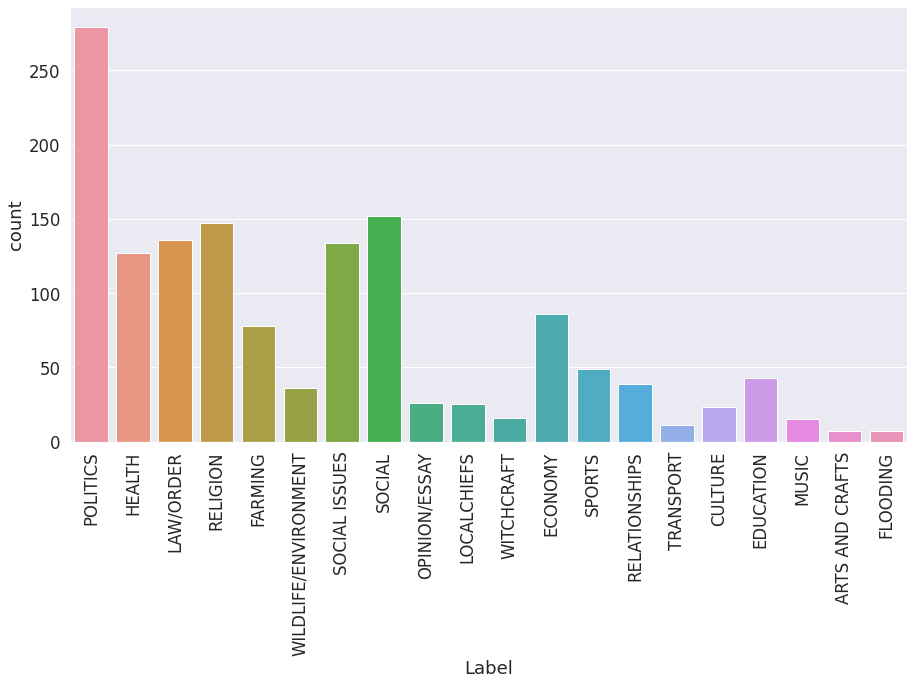

In [28]:
sns.set(style='darkgrid',font_scale=1.5)
plt.figure(figsize=(15,8))
plt.xticks(rotation =90)
sns.countplot(x='Label',data=train_new)
plt.show()

* Imbalanced data considering the labels

In [30]:
!pip install contractions

     |████████████████████████████████| 327kB 5.4MB/s 
     |████████████████████████████████| 286kB 8.3MB/s 
  Created wheel for pyahocorasick: filename=pyahocorasick-1.4.2-cp37-cp37m-linux_x86_64.whl size=85388 sha256=84c4c1e4db2092d4ea6a4237b48e5df014c5422ebfd1c51a27e38777ee764d8c
  Stored in directory: /root/.cache/pip/wheels/3a/03/34/77e3ece0bba8b86bfac88a79f923b36d805cad63caeba38842
Successfully built pyahocorasick


In [31]:
import string
from nltk.corpus import stopwords
import contractions
from wordcloud import WordCloud, STOPWORDS
from sklearn.feature_extraction.text import CountVectorizer, TfidfVectorizer

## Word Cloud Representation
Code copied from :https://www.kaggle.com/shishirkumar/toxic-comment-classification-eda

In [34]:
from PIL import Image
def display_cloud(label):
    plt.subplots(figsize=(10,10))
    text = train_new[train_new['Label']== label]["Text"].tolist()
    wc = WordCloud(
                          stopwords=STOPWORDS,
                          background_color='black',
                          collocations=False,
                          width=1800,
                          height=800,
                         )
    wc.generate(' '.join(text))
    plt.imshow(wc, interpolation="bilinear")
    plt.axis('off')
    plt.title(label,fontsize=36)
    plt.show()

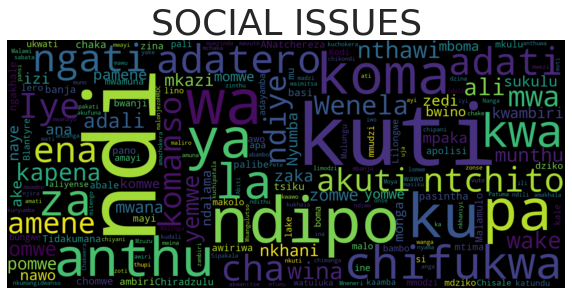

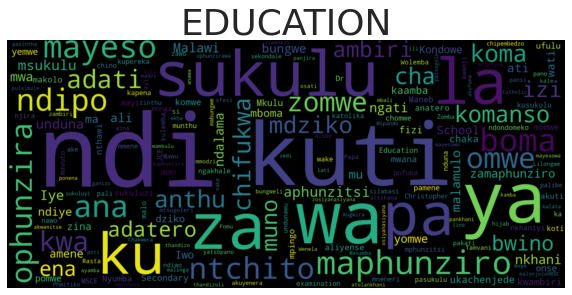

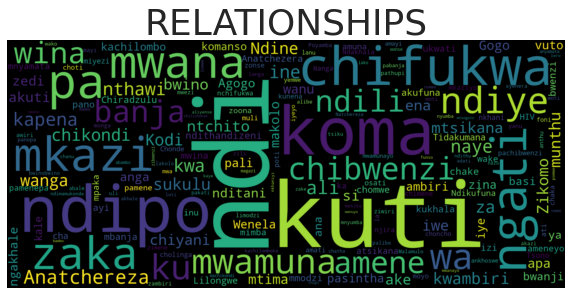

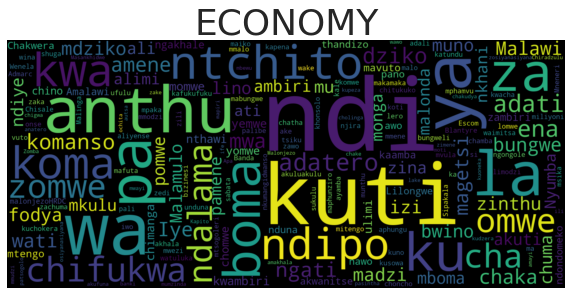

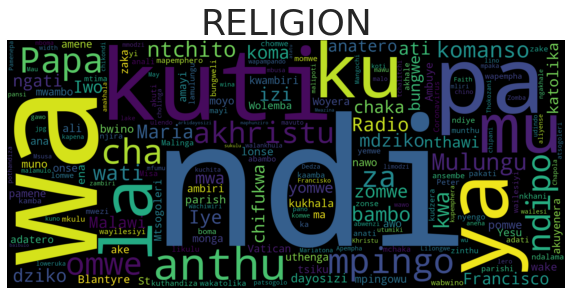

...

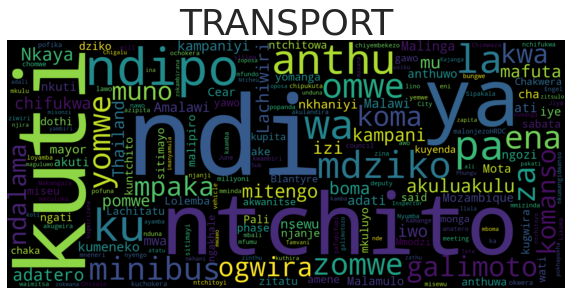

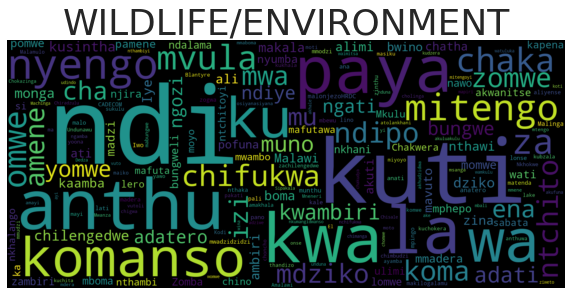

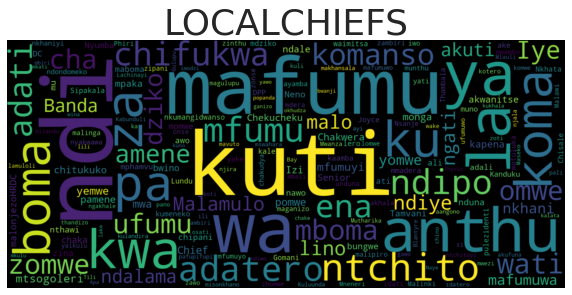

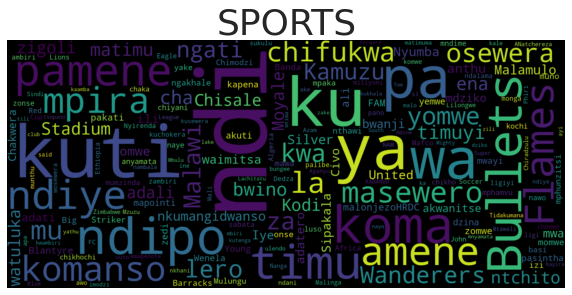

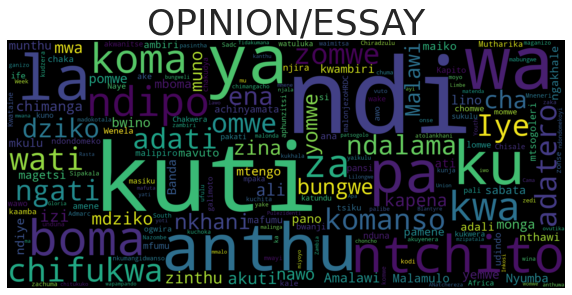

In [35]:
label_list = ['SOCIAL ISSUES', 'EDUCATION', 'RELATIONSHIPS', 'ECONOMY', 'RELIGION', 'POLITICS', 'LAW/ORDER', 'SOCIAL', 'HEALTH', 'ARTS AND CRAFTS', 'FARMING', 'CULTURE', 'FLOODING', 'WITCHCRAFT', 'MUSIC', 'TRANSPORT', 'WILDLIFE/ENVIRONMENT', 'LOCALCHIEFS', 'SPORTS', 'OPINION/ESSAY']
for label in label_list:
    display_cloud(label)

In [41]:
text_list = [len(x.split()) for x in train_new['Text'].values.tolist()]

In [46]:
print(f' The longest sentence in the Text columns contains {max(text_list)} words')

 The longest sentence in the Text columns contains 909 words


In [47]:
len(train_new[train_new['Label'] == 'RELIGION']['Text'].str.split())

147

In [77]:
len(train_new[train_new['Label'] == 'RELIGION']['Text'].str.split().values.tolist()[0])

224

In [79]:
len(train_new[train_new['Label'] == 'RELIGION']['Text'].str.split().values.tolist()[1])

120

In [81]:
word_df = pd.DataFrame({"Label":labels,'Count':words})

In [82]:
word_df.sort_values(by='Count',ascending=False)

,Label,Count
101,SOCIAL ISSUES,909
287,ECONOMY,873
1432,OPINION/ESSAY,848
278,ECONOMY,826
641,POLITICS,822
...,...,...
1278,MUSIC,60
669,POLITICS,55
728,LAW/ORDER,45
1220,FARMING,43


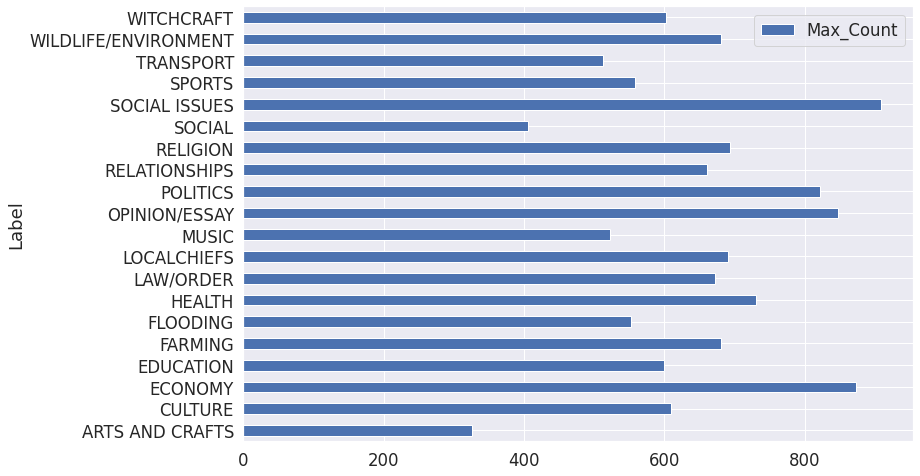

In [83]:
word_df.groupby('Label').max().reset_index().rename(columns={'Count':'Max_Count'}).set_index('Label').plot(kind='barh',figsize=(12,8))

* It is evident that the label SOCIAL ISSUES has the highest number of words

In [84]:
word_df.groupby('Label').max().reset_index().rename(columns={'Count':'Max_Count'})

,Label,Max_Count
0,ARTS AND CRAFTS,326
1,CULTURE,609
2,ECONOMY,873
3,EDUCATION,600
4,FARMING,681
5,FLOODING,553
6,HEALTH,731
7,LAW/ORDER,672
8,LOCALCHIEFS,690
9,MUSIC,523


In [68]:
train_new['Label'].value_counts()

POLITICS                279
SOCIAL                  152
RELIGION                147
LAW/ORDER               136
SOCIAL ISSUES           134
HEALTH                  127
ECONOMY                  86
FARMING                  78
SPORTS                   49
EDUCATION                43
RELATIONSHIPS            39
WILDLIFE/ENVIRONMENT     36
OPINION/ESSAY            26
LOCALCHIEFS              25
CULTURE                  23
WITCHCRAFT               16
MUSIC                    15
TRANSPORT                11
FLOODING                  7
ARTS AND CRAFTS           7
Name: Label, dtype: int64

In [13]:
def ret_char(text):
   text = re.sub("[^a-zA-Z]", " ", text)
   # convert text to lower case
   text = text.lower()
   # split text into tokens to remove whitespaces
   tokens = text.split()
   return " ".join(tokens)

In [14]:
train_new['Cleaned_Text'] = train_new['Text'].apply(lambda x : ret_char(x))

In [15]:
train_new.head()

,Text,Label,Cleaned_Text
0,Mwangonde: Khansala wachinyamata Akamati achi...,POLITICS,mwangonde khansala wachinyamata akamati achiny...
1,MCP siidakhutire ndi kalembera Chipani cha Ma...,POLITICS,mcp siidakhutire ndi kalembera chipani cha mal...
2,Bungwe la MANEPO Lapempha Boma Liganizire Anth...,HEALTH,bungwe la manepo lapempha boma liganizire anth...
3,Ndale zogawanitsa miyambo zanyanya Si zachile...,POLITICS,ndale zogawanitsa miyambo zanyanya si zachilen...
4,Nanga wapolisi ataphofomoka? Masiku ano sichi...,LAW/ORDER,nanga wapolisi ataphofomoka masiku ano sichikh...


In [16]:
train_new = train_new[['Cleaned_Text','Label']].copy()

In [89]:
words = []
labels = []
label_list = ['SOCIAL ISSUES', 'EDUCATION', 'RELATIONSHIPS', 'ECONOMY', 'RELIGION', 'POLITICS', 'LAW/ORDER', 'SOCIAL', 'HEALTH', 'ARTS AND CRAFTS', 'FARMING', 'CULTURE', 'FLOODING', 'WITCHCRAFT', 'MUSIC', 'TRANSPORT', 'WILDLIFE/ENVIRONMENT', 'LOCALCHIEFS', 'SPORTS', 'OPINION/ESSAY']
for label in label_list:
  text_count = train_new[train_new['Label'] == label]['Cleaned_Text'].str.split().values.tolist()
  for c in text_count:
    words.append(len(c))
    labels.append(label)

In [90]:
word_df = pd.DataFrame({"Label":labels,'Count':words})

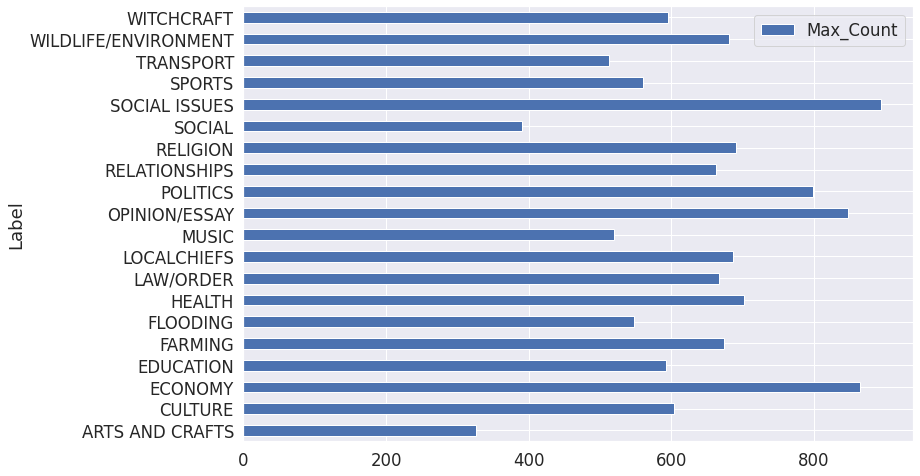

In [91]:
word_df.groupby('Label').max().reset_index().rename(columns={'Count':'Max_Count'}).set_index('Label').plot(kind='barh',figsize=(12,8))

In [92]:
word_df.groupby('Label').max().reset_index().rename(columns={'Count':'Max_Count'})

,Label,Max_Count
0,ARTS AND CRAFTS,326
1,CULTURE,603
2,ECONOMY,865
3,EDUCATION,592
4,FARMING,673
5,FLOODING,548
6,HEALTH,702
7,LAW/ORDER,666
8,LOCALCHIEFS,686
9,MUSIC,519


In [17]:
from sklearn.preprocessing import LabelEncoder
lb = LabelEncoder()
lb_encoded = lb.fit_transform(train_new['Label'])

In [18]:
lb.classes_

array(['ARTS AND CRAFTS', 'CULTURE', 'ECONOMY', 'EDUCATION', 'FARMING',
       'FLOODING', 'HEALTH', 'LAW/ORDER', 'LOCALCHIEFS', 'MUSIC',
       'OPINION/ESSAY', 'POLITICS', 'RELATIONSHIPS', 'RELIGION', 'SOCIAL',
       'SOCIAL ISSUES', 'SPORTS', 'TRANSPORT', 'WILDLIFE/ENVIRONMENT',
       'WITCHCRAFT'], dtype=object)

In [19]:
train_new['Label'] = lb_encoded

In [20]:
train_new.head()

,Cleaned_Text,Label
0,mwangonde khansala wachinyamata akamati achiny...,11
1,mcp siidakhutire ndi kalembera chipani cha mal...,11
2,bungwe la manepo lapempha boma liganizire anth...,6
3,ndale zogawanitsa miyambo zanyanya si zachilen...,11
4,nanga wapolisi ataphofomoka masiku ano sichikh...,7


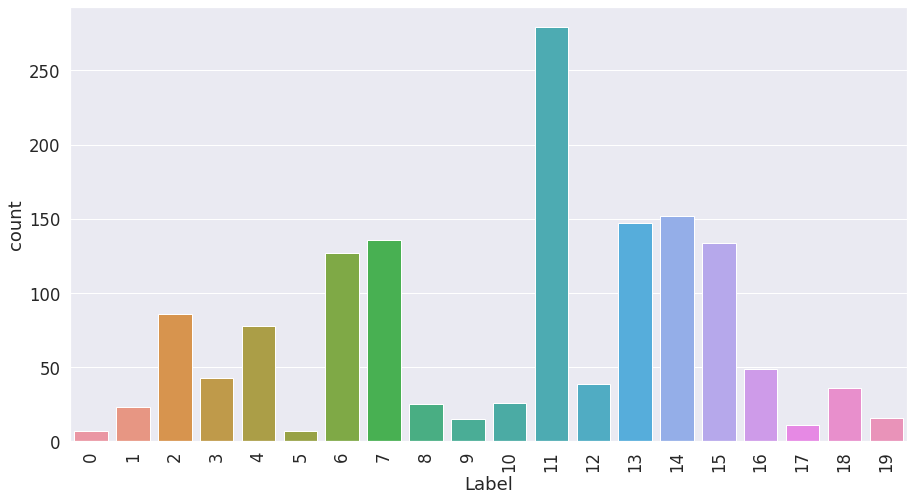

In [100]:
sns.set(style='darkgrid',font_scale=1.5)
plt.figure(figsize=(15,8))
plt.xticks(rotation =90)
sns.countplot(x='Label',data=train_new)
plt.show()

## Split the dataset into training ,validation and test set

In [21]:
X = train_new['Cleaned_Text']
Y = train_new['Label']

In [22]:
from sklearn.model_selection import train_test_split
# First Split for Train and Test
x_train,x_test,y_train,y_test = train_test_split(X, Y, test_size=0.1, stratify=Y,random_state=RANDOM_SEED,shuffle=True)
# Next split Train in to training and validation
x_tr,x_val,y_tr,y_val = train_test_split(x_train, y_train, test_size=0.2, stratify= y_train,random_state=RANDOM_SEED,shuffle=True)

In [134]:
x_tr

1262    atuma anthu kupha apolisi mboma la chitipa ats...
173     dpp ikutolera nambala zovotera ziyangoyango pa...
817     kuli zionetsero pa december lachitatu pa decem...
1123    amayi adandaulira boma pa za hiv edzi amayi om...
17      fetereza wa makuponi akusowa atero ena pamene ...
                              ...                        
1182    boma lilimbana ndi mchitidwe odzembetsa anthu ...
702     boma lilimbikitsa phunziro la sayansi wolemba ...
366     k biliyoni yothana ndi matenda a mkungudza bun...
1311    chakwera akwanitse malonjezohrdc bungwe la hum...
1168    ogwira ntchito mboma ayamba kunyanyala ntchito...
Name: Cleaned_Text, Length: 1033, dtype: object

In [174]:
y_tr.values

array([15, 11, 11, ..., 18, 11, 14])

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


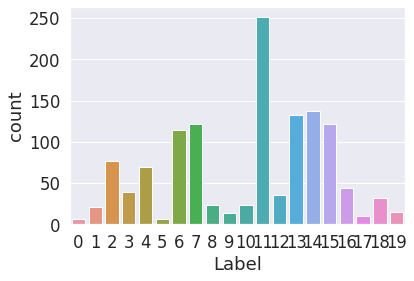

In [103]:
sns.countplot(y_train)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


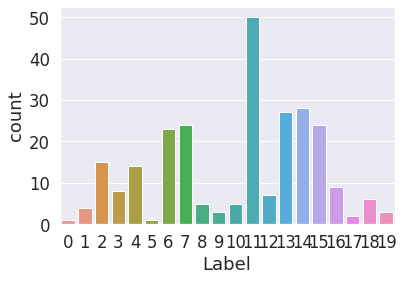

In [104]:
sns.countplot(y_val)

/usr/local/lib/python3.7/dist-packages/seaborn/_decorators.py:43: FutureWarning: Pass the following variable as a keyword arg: x. From version 0.12, the only valid positional argument will be `data`, and passing other arguments without an explicit keyword will result in an error or misinterpretation.
  FutureWarning


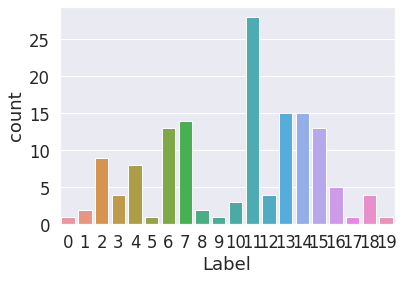

In [105]:
sns.countplot(y_test)

##Preparing the Dataset and DataModule 

In [23]:
class NewsDataset (Dataset):
    def __init__(self,quest,tags, tokenizer, max_len):
        self.tokenizer = tokenizer
        self.text = quest
        self.labels = tags
        self.max_len = max_len
        
    def __len__(self):
        return len(self.text)
    
    def __getitem__(self, item_idx):
        text = self.text[item_idx]
        inputs = self.tokenizer.encode_plus(
            text,
            None,
            add_special_tokens=True, # Add [CLS] [SEP]
            max_length= self.max_len,
            padding = 'max_length',
            return_token_type_ids= False,
            return_attention_mask= True, # Differentiates padded vs normal token
            truncation=True, # Truncate data beyond max length
            return_tensors = 'pt' # PyTorch Tensor format
          )
        
        input_ids = inputs['input_ids'].flatten()
        attn_mask = inputs['attention_mask'].flatten()
        #token_type_ids = inputs["token_type_ids"]
        
        return {
            'input_ids': input_ids ,
            'attention_mask': attn_mask,
            'label': torch.tensor(self.labels[item_idx], dtype=torch.float)}
            

In [24]:
class NewsDataModule(pl.LightningDataModule):
    
    def __init__(self,x_tr,y_tr,x_val,y_val,x_test,y_test,tokenizer,batch_size=16,max_token_len=900):
        super().__init__()
        self.tr_text = x_tr.values
        self.tr_label = y_tr.values
        self.val_text = x_val.values
        self.val_label = y_val.values
        self.test_text = x_test.values
        self.test_label = y_test.values
        self.tokenizer = tokenizer
        self.batch_size = batch_size
        self.max_token_len = max_token_len

    def setup(self):
        self.train_dataset = NewsDataset(quest=self.tr_text, tags=self.tr_label, tokenizer=self.tokenizer,max_len = self.max_token_len)
        self.val_dataset  = NewsDataset(quest=self.val_text,tags=self.val_label,tokenizer=self.tokenizer,max_len = self.max_token_len)
        self.test_dataset  = NewsDataset(quest=self.test_text,tags=self.test_label,tokenizer=self.tokenizer,max_len = self.max_token_len)
        
        
    def train_dataloader(self):
        return DataLoader(self.train_dataset,batch_size = self.batch_size,shuffle = True,num_workers=4)

    def val_dataloader(self):
        return DataLoader(self.val_dataset,batch_size= 16,num_workers=4)

    def test_dataloader(self):
        return DataLoader(self.test_dataset,batch_size= 16)

In [25]:
# Initialize the Bert tokenizer
BERT_MODEL_NAME = "bert-base-cased" # we will use the BERT base model(the smaller one)
Bert_tokenizer = BertTokenizer.from_pretrained(BERT_MODEL_NAME)

In [26]:
Bert_tokenizer

PreTrainedTokenizer(name_or_path='bert-base-cased', vocab_size=28996, model_max_len=512, is_fast=False, padding_side='right', special_tokens={'unk_token': '[UNK]', 'sep_token': '[SEP]', 'pad_token': '[PAD]', 'cls_token': '[CLS]', 'mask_token': '[MASK]'})

In [185]:
max_word_cnt = 300
quest_cnt = 0

# For every sentence...
for question in X:

    # Tokenize the text and add `[CLS]` and `[SEP]` tokens.
    input_ids = Bert_tokenizer.encode(question, add_special_tokens=True)

    # Update the maximum sentence length.
    if len(input_ids) > max_word_cnt:
        quest_cnt +=1

print(f'# Question having word count > {max_word_cnt}: is  {quest_cnt}')

# Question having word count > 300: is  1376


In [28]:
# Initialize the parameters that will be use for training
N_EPOCHS = 12
BATCH_SIZE = 8
MAX_LEN = 300
LR = 2e-05

In [29]:
# Instantiate and set up the data_module
Newsdata_module = NewsDataModule(x_tr,y_tr,x_val,y_val,x_test,y_test,Bert_tokenizer,BATCH_SIZE,MAX_LEN)
Newsdata_module.setup()

In [30]:
loader = Newsdata_module.train_dataloader()

In [31]:
for i,batch in enumerate(loader):
  print(batch)
  break

{'input_ids': tensor([[  101,  1195,  6602,  ...,  8032, 10073,   102],
        [  101,   184, 10606,  ..., 17485,  2822,   102],
        [  101,   171, 17506,  ...,   180, 12658,   102],
        ...,
        [  101,   170, 14386,  ...,  3309,  5674,   102],
        [  101,  1126,  1161,  ...,  1161,   183,   102],
        [  101,  1301,  3276,  ...,  3624, 13685,   102]]), 'attention_mask': tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), 'label': tensor([ 4., 11.,  1., 11.,  1.,  7., 18., 11.])}


## Train the Model

In [244]:
len(label_list)

20

In [33]:
class NewsClassifier(pl.LightningModule):
    # Set up the classifier
    def __init__(self, n_classes=20, steps_per_epoch=None, n_epochs=3, lr=2e-5 ):
        super().__init__()

        self.bert = BertModel.from_pretrained(BERT_MODEL_NAME, return_dict=True)
        self.pre_classifier = torch.nn.Linear(self.bert.config.hidden_size, 768)
        self.dropout = torch.nn.Dropout(0.3)
        self.classifier = nn.Linear(768,n_classes) # outputs = number of labels
        self.steps_per_epoch = steps_per_epoch
        self.n_epochs = n_epochs
        self.lr = lr
        self.criterion = nn.CrossEntropyLoss()
        
    def forward(self,input_ids, attn_mask):
        output = self.bert(input_ids = input_ids ,attention_mask = attn_mask)
        pooler = self.pre_classifier(output.pooler_output)
        pooler = torch.nn.ReLU()(pooler)
        pooler = self.dropout(pooler)
        output = self.classifier(pooler)
                
        return output
    
    
    def training_step(self,batch,batch_idx):
        input_ids = batch['input_ids']
        attention_mask = batch['attention_mask']
        labels = batch['label'].long()
        
        outputs = self(input_ids,attention_mask)
        #outputs = outputs.argmax().items()
        loss = self.criterion(outputs,labels)
        self.log('train_loss',loss , prog_bar=True,logger=True)
        
        return {"loss" :loss, "predictions":outputs, "labels": labels }


    def validation_step(self,batch,batch_idx):
        input_ids = batch['input_ids']
        attention_mask = batch['attention_mask']
        labels = batch['label'].to(device, dtype = torch.long)
        
        outputs = self(input_ids,attention_mask)
        loss = self.criterion(outputs,labels)
        self.log('val_loss',loss , prog_bar=True,logger=True)
        
        return loss

    def test_step(self,batch,batch_idx):
        input_ids = batch['input_ids']
        attention_mask = batch['attention_mask']
        labels = batch['label'].to(device, dtype = torch.long)
        
        outputs = self(input_ids,attention_mask)
        loss = self.criterion(outputs,labels)
        self.log('test_loss',loss , prog_bar=True,logger=True)
        
        return loss
    
    
    def configure_optimizers(self):
        optimizer = AdamW(self.parameters() , lr=self.lr)
        warmup_steps = self.steps_per_epoch//3
        total_steps = self.steps_per_epoch * self.n_epochs - warmup_steps

        scheduler = get_linear_schedule_with_warmup(optimizer,warmup_steps,total_steps)

        return [optimizer], [scheduler]


In [35]:
# Instantiate the classifier model
steps_per_epoch = len(x_tr)//BATCH_SIZE
model = NewsClassifier(n_classes=20, steps_per_epoch=steps_per_epoch,n_epochs=N_EPOCHS,lr=LR)

In [36]:
#Initialize Pytorch Lightning callback for Model checkpointing

# saves a file like: input/QTag-epoch=02-val_loss=0.32.ckpt
checkpoint_callback = ModelCheckpoint(
    monitor='val_loss',# monitored quantity
    filename='News-{epoch:02d}-{val_loss:.2f}',
    save_top_k=3, #  save the top 3 models
    mode='min', # mode of the monitored quantity  for optimization
)

In [37]:
# Instantiate the Model Trainer
trainer = pl.Trainer(max_epochs = N_EPOCHS , gpus = 1, callbacks=[checkpoint_callback],progress_bar_refresh_rate = 30)

GPU available: True, used: True
TPU available: False, using: 0 TPU cores


In [38]:
!nvidia-smi

Sun Apr 18 18:48:06 2021       
+-----------------------------------------------------------------------------+
| NVIDIA-SMI 460.67       Driver Version: 460.32.03    CUDA Version: 11.2     |
|-------------------------------+----------------------+----------------------+
| GPU  Name        Persistence-M| Bus-Id        Disp.A | Volatile Uncorr. ECC |
| Fan  Temp  Perf  Pwr:Usage/Cap|         Memory-Usage | GPU-Util  Compute M. |
|                               |                      |               MIG M. |
|===============================+======================+======================|
|   0  Tesla P100-PCIE...  Off  | 00000000:00:04.0 Off |                    0 |
| N/A   33C    P0    25W / 250W |      2MiB / 16280MiB |      0%      Default |
|                               |                      |                  N/A |
+-------------------------------+----------------------+----------------------+
                                                                               
+-------

In [239]:
!ps -aux|grep python

root          61  0.1  0.4 289932 122104 ?       Sl   11:27   0:30 /usr/bin/python2 /usr/local/bin/jupyter-notebook --ip="172.28.0.2" --port=9000 --FileContentsManager.root_dir="/" --LargeFileManager.delete_to_trash=False --MappingKernelManager.root_dir="/content"
root          74  1.5 26.1 37833144 6983272 ?    Ssl  11:59   5:17 /usr/bin/python3 -m ipykernel_launcher -f /root/.local/share/jupyter/runtime/kernel-9db726e4-51f4-4f65-8874-f75a597e77e8.json
root          96  0.2  0.0 129184 16848 ?        Sl   11:59   0:58 /usr/bin/python3 /usr/local/lib/python3.7/dist-packages/debugpy/adapter --for-server 45735 --host 127.0.0.1 --port 24362 --server-access-token 70590bab306b0bf0d7aad4d2cf24a33d687deff48c7292d0cb044fed7b24cade
root         412  0.0  0.0  18384  3056 ?        S    12:10   0:00 bash -c tail -n +0 -F "/root/.config/Google/DriveFS/Logs/drive_fs.txt" | python3 /opt/google/drive/drive-filter.py > "/root/.config/Google/DriveFS/Logs/timeouts.txt" 
root         414  0.0  0.0  31744

In [238]:
!sudo kill -9 PID

kill: failed to parse argument: 'PID'


In [249]:
torch.cuda.empty_cache()

In [39]:
# Train the Classifier Model
trainer.fit(model, Newsdata_module)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]

  | Name           | Type             | Params
----------------------------------------------------
0 | bert           | BertModel        | 108 M 
1 | pre_classifier | Linear           | 590 K 
2 | dropout        | Dropout          | 0     
3 | classifier     | Linear           | 15.4 K
4 | criterion      | CrossEntropyLoss | 0     
----------------------------------------------------
108 M     Trainable params
0         Non-trainable params
108 M     Total params
435.665   Total estimated model params size (MB)


1

## Evaluate the model performance on the test dataset

In [40]:
trainer.test(model,datamodule=Newsdata_module)

LOCAL_RANK: 0 - CUDA_VISIBLE_DEVICES: [0]
/usr/local/lib/python3.7/dist-packages/pytorch_lightning/utilities/distributed.py:68: UserWarning: The dataloader, test dataloader 0, does not have many workers which may be a bottleneck. Consider increasing the value of the `num_workers` argument` (try 4 which is the number of cpus on this machine) in the `DataLoader` init to improve performance.
  warnings.warn(*args, **kwargs)



--------------------------------------------------------------------------------
DATALOADER:0 TEST RESULTS
{'test_loss': 2.171985387802124}
--------------------------------------------------------------------------------


[{'test_loss': 2.171985387802124}]

In [41]:
# Visualize the logs using tensorboard.
%load_ext tensorboard
%tensorboard --logdir lightning_logs/

<IPython.core.display.Javascript object>

## Evaluate Model Performance on Test Set

In [42]:
model_path = checkpoint_callback.best_model_path
model_path

'/content/lightning_logs/version_0/checkpoints/News-epoch=11-val_loss=2.24.ckpt'

In [43]:
test.head()

,ID,Text
0,ID_ADHEtjTi,Abambo odzikhweza akuchuluka Kafukufuku wa ap...
1,ID_AHfJktdQ,Ambuye Ziyaye Ayamikira Aphunzitsi a Tilitonse...
2,ID_AUJIHpZr,Anatcheleza: Akundiopseza a gogo wanga Akundi...
3,ID_AUKYBbIM,Ulova wafika posauzana Adatenga digiri ya uph...
4,ID_AZnsVPEi,"Dzombe kukoma, koma Kuyambira makedzana, pant..."


In [44]:
test['Cleaned_Text'] = test['Text'].apply(lambda x : ret_char(x))

In [45]:
test.head()

,ID,Text,Cleaned_Text
0,ID_ADHEtjTi,Abambo odzikhweza akuchuluka Kafukufuku wa ap...,abambo odzikhweza akuchuluka kafukufuku wa apo...
1,ID_AHfJktdQ,Ambuye Ziyaye Ayamikira Aphunzitsi a Tilitonse...,ambuye ziyaye ayamikira aphunzitsi a tilitonse...
2,ID_AUJIHpZr,Anatcheleza: Akundiopseza a gogo wanga Akundi...,anatcheleza akundiopseza a gogo wanga akundiop...
3,ID_AUKYBbIM,Ulova wafika posauzana Adatenga digiri ya uph...,ulova wafika posauzana adatenga digiri ya uphu...
4,ID_AZnsVPEi,"Dzombe kukoma, koma Kuyambira makedzana, pant...",dzombe kukoma koma kuyambira makedzana panthaw...


In [46]:
test_new = test[['Cleaned_Text']].copy()

In [49]:
from torch.utils.data import TensorDataset

# Tokenize all questions in x_test
input_ids = []
attention_masks = []


for quest in x_test:
    encoded_quest =  Bert_tokenizer.encode_plus(
                    quest,
                    None,
                    add_special_tokens=True,
                    max_length= MAX_LEN,
                    padding = 'max_length',
                    return_token_type_ids= False,
                    return_attention_mask= True,
                    truncation=True,
                    return_tensors = 'pt'      
    )
    
    # Add the input_ids from encoded question to the list.    
    input_ids.append(encoded_quest['input_ids'])
    # Add its attention mask 
    attention_masks.append(encoded_quest['attention_mask'])
    
# Now convert the lists into tensors.
input_ids = torch.cat(input_ids, dim=0)
attention_masks = torch.cat(attention_masks, dim=0)
labels = torch.tensor(y_test.values)

# Set the batch size.  
TEST_BATCH_SIZE = 8

# Create the DataLoader.
pred_data = TensorDataset(input_ids, attention_masks, labels)
pred_sampler = SequentialSampler(pred_data)
pred_dataloader = DataLoader(pred_data, sampler=pred_sampler, batch_size=TEST_BATCH_SIZE)

In [50]:
pred_data[0]

(tensor([  101,   170, 14386,  1182,   170,  1377, 10073,  1181,  6185,  1161,
         22904,  6583,   180,  1358, 24928,  2728,   170,  4786,  3624,  3820,
          9368,  5132,   180, 16065,  8050,  2193, 12253,  5674,   182,  7767,
          1182,   180,  4455,  2328,  2403,  2758,  1126,  4164,  1182,   170,
         14386,  1182,   182,  4043,  1918,  2495, 24928,  2728,  2495, 22952,
         10279,  8050,  1389,  3174,  1777, 22904,  6583,   185, 24611,  3820,
          9368,  5132,   180, 16065,  8050,  2193, 12253,  5674,   182,  7767,
          1182,   185,  1161, 13280,  8057,   195,  1161,  2403,  2758,  1126,
          4164,  1182,   184,  1306,  7921,  8050, 19226,  1777,   180,  4455,
          8961,  3624,   183,  3309, 22904,  6583,   184,  5954,  1161,   185,
         24611,  3820,  9368,  5132,   180, 16065,   183,  3309, 12821,  8050,
          7531, 12253,  4955,  1424,  5303, 26063,  1306,  7921, 25021, 25890,
          1161,   182,  2145,  7223,  1605, 20049,  

In [51]:
for batch in pred_dataloader:
  print(batch)

[tensor([[  101,   170, 14386,  ...,   170, 17485,   102],
        [  101, 21359,  1566,  ...,  2571,   180,   102],
        [  101,   180, 15818,  ...,   180,  1818,   102],
        ...,
        [  101,   185,  5521,  ..., 15796,  4455,   102],
        [  101,   185, 26519,  ...,  1161,  1146,   102],
        [  101,   171,  7903,  ...,  1126, 19987,   102]]), tensor([[1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        ...,
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1],
        [1, 1, 1,  ..., 1, 1, 1]]), tensor([ 7,  6, 13,  6, 15, 13, 14,  2])]
[tensor([[  101,  3505,  3496,  ...,  3293,  1830,   102],
        [  101,   195,  1161,  ...,   170,  6709,   102],
        [  101,   190,  1204,  ..., 11451,  7192,   102],
        ...,
        [  101,  5580, 19463,  ...,  1821,  7291,   102],
        [  101,  6340,  5971,  ...,  7301,   170,   102],
        [  101,  1821,  3715,  ...,     0,     0,     0]]), tensor([[1,

In [52]:
flat_pred_outs = 0
flat_true_labels = 0

In [53]:
# Put model in evaluation mode
model.eval()

# Tracking variables 
pred_outs, true_labels = [], []
#i=0
# Predict 
for batch in pred_dataloader:
    # Add batch to GPU
    batch = tuple(t.to(device) for t in batch)
  
    # Unpack the inputs from our dataloader
    b_input_ids, b_attn_mask, b_labels = batch
 
    with torch.no_grad():
        # Forward pass, calculate logit predictions
        pred_out = model(b_input_ids,b_attn_mask)
        pred_out = torch.sigmoid(pred_out)
        # Move predicted output and labels to CPU
        pred_out = pred_out.detach().cpu().numpy()
        label_ids = b_labels.to('cpu').numpy()
        #i+=1
        # Store predictions and true labels
        #print(i)
        #print(outputs)
        #print(logits)
        #print(label_ids)
    pred_outs.append(pred_out)
    true_labels.append(label_ids)

In [54]:
pred_outs[0][0]

array([0.229071  , 0.36629948, 0.6763237 , 0.38777077, 0.638919  ,
       0.26256362, 0.67842937, 0.78476846, 0.39112827, 0.33079982,
       0.41069135, 0.86043596, 0.4147459 , 0.34234565, 0.481429  ,
       0.7926796 , 0.43316904, 0.30506402, 0.48432004, 0.34181735],
      dtype=float32)

In [55]:
# Combine the results across all batches. 
flat_pred_outs = np.concatenate(pred_outs, axis=0)

# Combine the correct labels for each batch into a single list.
flat_true_labels = np.concatenate(true_labels, axis=0)

In [56]:
flat_pred_outs.shape , flat_true_labels.shape

((144, 20), (144,))

In [66]:
flat_pred_outs

array([[0.229071  , 0.36629948, 0.6763237 , ..., 0.30506402, 0.48432004,
        0.34181735],
       [0.26554516, 0.3994335 , 0.66328347, ..., 0.3271644 , 0.48194593,
        0.37459248],
       [0.47562414, 0.40942636, 0.5554369 , ..., 0.42338413, 0.41583046,
        0.4631589 ],
       ...,
       [0.39513597, 0.42633966, 0.6135078 , ..., 0.38867265, 0.42259312,
        0.4489085 ],
       [0.20751397, 0.300027  , 0.490166  , ..., 0.24325898, 0.42349473,
        0.24557188],
       [0.19098975, 0.34342918, 0.6547798 , ..., 0.2738621 , 0.44303924,
        0.3145999 ]], dtype=float32)

In [65]:
flat_true_labels

array([ 7,  6, 13,  6, 15, 13, 14,  2, 11,  4, 11, 13,  7,  1, 14, 12, 11,
       11,  2,  7, 13,  6, 12,  9, 16,  6,  2, 16, 11, 14, 11,  7,  6, 14,
       18, 11,  4, 13, 13, 14,  2,  3, 11, 10, 11, 18, 13, 13,  3,  8, 17,
        2,  6,  4, 11, 15,  7, 15, 16, 11,  6,  5, 11, 15,  6, 11, 11, 19,
       13,  8,  7, 11, 15,  4,  0, 15,  7, 16, 13,  2, 12, 11,  4, 18, 11,
        6, 11, 14,  6,  7,  6,  7, 16,  7, 11, 14, 15, 11,  1,  7,  2, 11,
       11,  3, 12,  2, 13, 15, 11, 14, 15,  3, 13, 15, 14,  4,  2, 11,  4,
        6,  7, 14, 10, 11,  7, 15, 13, 15, 15, 14, 18, 14, 13,  4, 13, 14,
       10,  6, 11, 14, 14, 11,  7, 11])

## Predictions of Tags in Test set

In [59]:
#define candidate threshold values
threshold  = np.arange(0.4,0.51,0.01)
threshold

array([0.4 , 0.41, 0.42, 0.43, 0.44, 0.45, 0.46, 0.47, 0.48, 0.49, 0.5 ])

In [60]:
# convert probabilities into 0 or 1 based on a threshold value
def classify(pred_prob,thresh):
    y_pred = []

    for tag_label_row in pred_prob:
        temp=[]
        for tag_label in tag_label_row:
            if tag_label >= thresh:
                temp.append(1) # Infer tag value as 1 (present)
            else:
                temp.append(0) # Infer tag value as 0 (absent)
        y_pred.append(temp)

    return y_pred

In [61]:
flat_true_labels[10]

11

In [67]:
flat_true_labels.ravel() 

array([ 7,  6, 13,  6, 15, 13, 14,  2, 11,  4, 11, 13,  7,  1, 14, 12, 11,
       11,  2,  7, 13,  6, 12,  9, 16,  6,  2, 16, 11, 14, 11,  7,  6, 14,
       18, 11,  4, 13, 13, 14,  2,  3, 11, 10, 11, 18, 13, 13,  3,  8, 17,
        2,  6,  4, 11, 15,  7, 15, 16, 11,  6,  5, 11, 15,  6, 11, 11, 19,
       13,  8,  7, 11, 15,  4,  0, 15,  7, 16, 13,  2, 12, 11,  4, 18, 11,
        6, 11, 14,  6,  7,  6,  7, 16,  7, 11, 14, 15, 11,  1,  7,  2, 11,
       11,  3, 12,  2, 13, 15, 11, 14, 15,  3, 13, 15, 14,  4,  2, 11,  4,
        6,  7, 14, 10, 11,  7, 15, 13, 15, 15, 14, 18, 14, 13,  4, 13, 14,
       10,  6, 11, 14, 14, 11,  7, 11])

In [69]:
y_pred = []
for i in flat_pred_outs:
  y_pred.append(np.argmax(i))

In [70]:
len(y_pred)

144

In [71]:
from sklearn.metrics import *
accuracy_score(y_pred,flat_true_labels)

0.3333333333333333

In [72]:
print(classification_report(y_pred,flat_true_labels))

              precision    recall  f1-score   support

           0       0.00      0.00      0.00         0
           1       0.00      0.00      0.00         0
           2       0.00      0.00      0.00         0
           3       0.00      0.00      0.00         0
           4       0.00      0.00      0.00         0
           5       0.00      0.00      0.00         0
           6       0.00      0.00      0.00         0
           7       0.00      0.00      0.00         0
           8       0.00      0.00      0.00         0
           9       0.00      0.00      0.00         0
          10       0.00      0.00      0.00         0
          11       0.75      0.40      0.52        53
          12       0.00      0.00      0.00         0
          13       0.80      0.52      0.63        23
          14       0.27      0.29      0.28        14
          15       0.85      0.20      0.33        54
          16       0.00      0.00      0.00         0
          17       0.00    

/usr/local/lib/python3.7/dist-packages/sklearn/metrics/_classification.py:1272: UndefinedMetricWarning: Recall and F-score are ill-defined and being set to 0.0 in labels with no true samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, msg_start, len(result))
